In [1]:
import pandas as pd
import json
import matplotlib.pyplot as plt
%matplotlib inline
from wordcloud import WordCloud
import nltk
from nltk.corpus import stopwords, words as ws, wordnet
from nltk.tokenize import word_tokenize
import re
import string
import enchant
import os
from collections import Counter
import seaborn as sns


In [17]:
rand = "havent gone inn  a while"
word_tokens = word_tokenize(rand)
print(word_tokens)
# engDict = enchant.Dict("en_US")

In [2]:
stop_words = stopwords.words('english')
new_stopwords = ['get','dont','im','would']
stop_words.extend(new_stopwords)
stop_words = set(stop_words)
# word_tokens = word_tokenize()
print(stop_words)

regular_punct = list(string.punctuation)
regular_punct.append('’')


def remove_punctuation(text, punct_list=regular_punct):
    for punc in punct_list:
        if punc in text:
            text = text.replace(punc, '')
    return text.strip()


def get_comments(subreddit):
    filename = 'posts_' + subreddit + '.json'
    with open('data/'+filename, 'r') as f:
        text = ''
        c = 0
        data = json.load(f)
        for post in data:
            for com in post['comments']:
                for i in com.values():
                    c += 1
                    text += str(i) + ' '
        # print(text)
        # with open('csgo.txt', 'w') as f:
            # f.write(text)\
        text = text.lower()
        return text
    
def preprocess(subreddit):
    text = get_comments(subreddit)

    # remove hyperlinks
    lst = re.findall('http://\S+|https://\S+', text)
    for i in lst:
        text = text.replace(i, '')
    text = remove_punctuation(text)
    clean_text = ""
    for word in text.split():
        if word not in stop_words:
            clean_text+=(word+" ")
    text = clean_text[:-1]
    return text

def wordcloud(text, save=False, subreddit=None, slang=False):
    word_cloud1 = WordCloud(collocations=False, background_color='white', stopwords=stop_words,
                            width=2048, height=1080).generate(text)
    
    if not save:
        plt.figure(figsize=(20, 40))
        plt.imshow(word_cloud1, interpolation='bilinear')
    else:
        if slang:
            filename = subreddit + '/reddit_' + subreddit + '_slang.png'
        else:
            filename = subreddit + '/reddit_' + subreddit + '.png'
        word_cloud1.to_file(filename)

{'whom', 'am', 'yourselves', 'when', "doesn't", 'doing', 'through', 'each', 'so', 've', 'your', 'he', 'while', 'were', "don't", "couldn't", 'couldn', 'yours', 'hasn', "you've", 'again', 'and', 'wasn', 'hadn', 'too', 'm', 'ain', 'which', 'our', 'own', 'down', 's', 'my', 'dont', "haven't", 'shan', 'an', 'nor', 'below', 'most', 'been', 'being', 'don', 'as', 'we', 'won', "shouldn't", "you'll", "you're", "didn't", "hasn't", 'yourself', 'or', 'o', "needn't", 'their', 'there', 'any', 'only', 'having', "isn't", "won't", 'she', 'should', "mightn't", 'me', 'y', 'didn', 'of', 'needn', 'ourselves', 'with', 'her', 'shouldn', "weren't", 'here', 'such', 'other', 'did', "you'd", 'all', 'then', 'why', 'that', 'has', 'than', 'are', 'not', 'now', 'in', 'until', 'both', 'off', "wouldn't", 'be', 'more', 'its', 'had', 'by', 'will', 'on', 'you', 'once', "hadn't", 'they', 'between', 'same', 'at', 'but', 'can', 'this', 'after', 'to', 'ma', 'does', 'do', 'from', 'll', 'about', 'what', 'some', 'himself', "she's"

In [32]:
subreddits = ["girlgamers", "gaming", "csgo", "dota2", "leagueoflegends",  "minecraft", "eldenring", "truegaming", "overwatch",
              "mademesmile", "wholesomememes", "politicalhumor", "memes", "funny", "askreddit", 'aww', 'worldnews', 'movies', 'todayilearned']

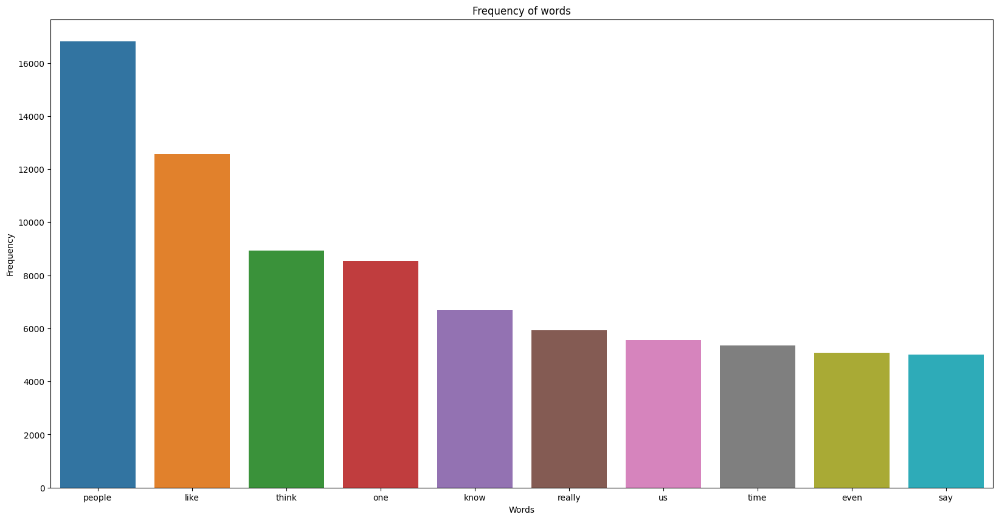

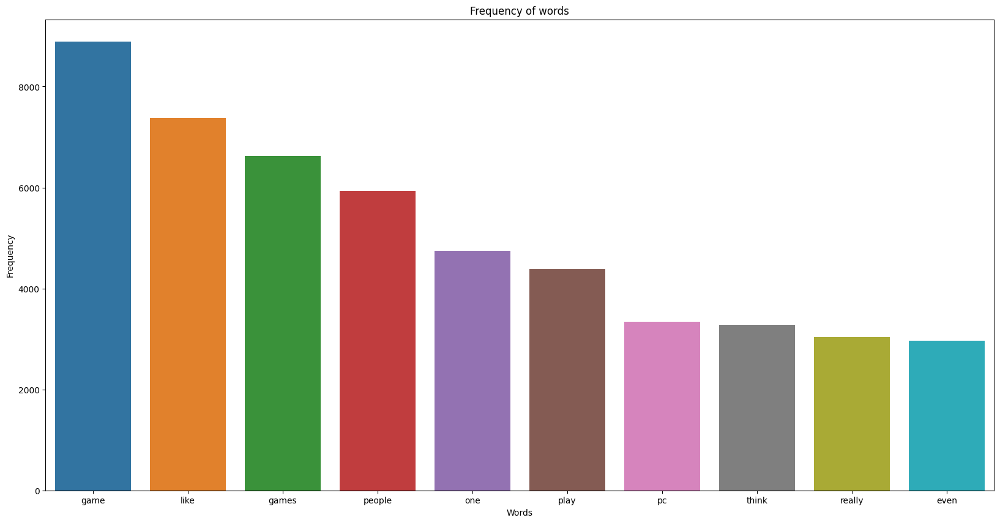

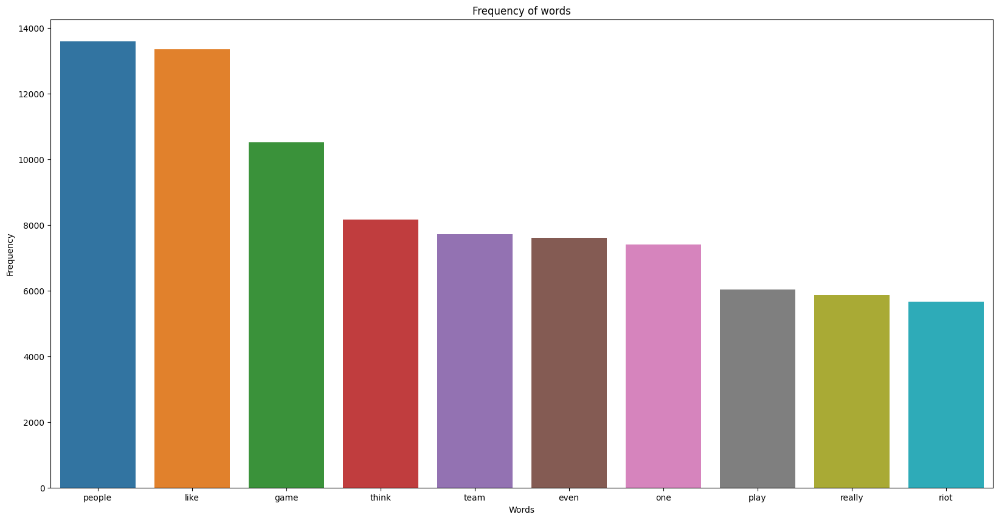

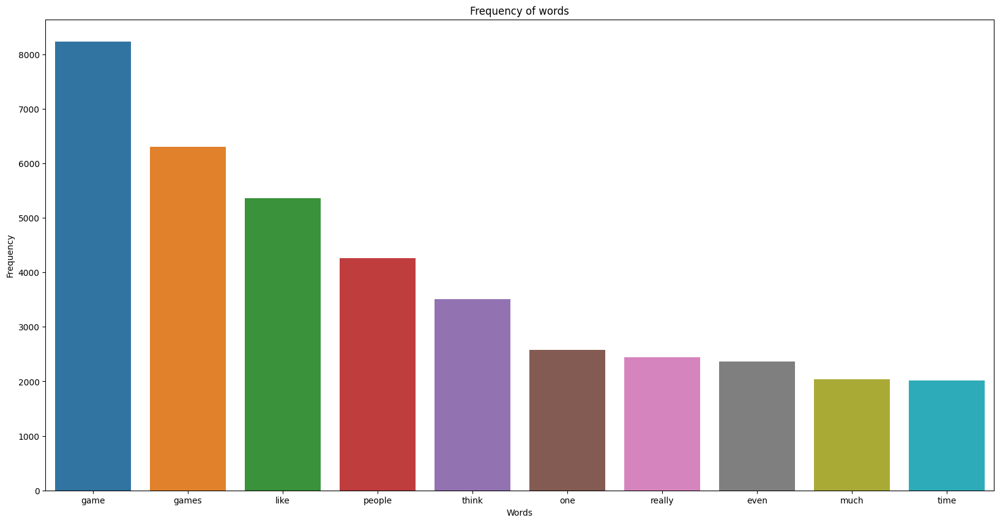

In [27]:

subreddits = ['askreddit', 'gaming', 'leagueoflegends', 'truegaming']
for subreddit in subreddits:
    # if folder does not exist, create it
    if not os.path.exists(subreddit):
        os.mkdir(subreddit)

    text = preprocess(subreddit)
    # to file
    with open('rand_'+subreddit+'.txt', 'wb') as f:
        f.write(text.encode('utf8'))

    # word cloud
    word_cloud1 = WordCloud(collocations=False, background_color='white', stopwords=stop_words,
                            width=2048, height=1080).generate(text)
    
    filename = subreddit + '/reddit_' + subreddit + '.png'
    word_cloud1.to_file(filename)
    # plt.figure(figsize=(20, 40))
    # plt.imshow(word_cloud1, interpolation='bilinear')
    # # print(text)
    # plt.axis('off')
    # # plt.show()

    word_count = Counter(text.lower().split())
    word_list = []
    word_counts = []
    for word in word_count.most_common(10):
        word_list.append(word[0])
        word_counts.append(word[1])

    # Plot for Frequency of words without removal of emojis/non-english words
    plt.figure(figsize=(20, 10))
    print(word_list[0])
    sns.barplot(x=word_list, y=word_counts)
    plt.xlabel("Words")
    plt.ylabel("Frequency")
    plt.title("Frequency of words")
    plt.axis('on')
    plt.savefig(subreddit + '/reddit_' + subreddit + '_freq.png')


In [21]:
import advertools as adv

for subreddit in subreddits:
    # if folder does not exist, create it
    if not os.path.exists(subreddit):
        os.mkdir(subreddit)
    text = get_comments(subreddit)
    print("Extracted ",len(text)," comments...")
    # remove hyperlinks
    lst = re.findall('http://\S+|https://\S+', text)
    for i in lst:
        text = text.replace(i, '')
    # remove punctuation
    text = remove_punctuation(text)
    emoji_summary = adv.extract_emoji(text)
    print(emoji_summary['emoji_flat'])
    print(emoji_summary['emoji_flat_text'])
    print(emoji_summary['top_emoji'])
    print(emoji_summary['top_emoji_sub_groups'])
    

KeyboardInterrupt: 

In [25]:
# sample text
# text = 'Lol I think I need some ZZZs before I go out. LOL, that was a funny joke!'
from tqdm import tqdm
from functools import reduce

english_words = set(ws.words())
common_words = []

for subreddit in tqdm(subreddits):
    if not os.path.exists(subreddit):
        os.mkdir(subreddit)
    print("Processing "+subreddit+"... ")
    text = preprocess(subreddit)
    print("Comments extracted and preprocessed...")
    # regular expression to match slang words and acronyms
    pattern = re.compile(r'\b\w{2,}\b')

    # tokenize the text into words and match the regular expression
    words = pattern.findall(text)

    # count the frequency of each word using a Counter object
    word_counts = Counter(words)

    # filter out words that appear more frequently than a threshold
    threshold = len(words)/len(word_counts)  # avg num_words
    print("Avg number of word occurences = ",threshold)
    frequent_words = [word for word, count in word_counts.items() if count>threshold]
    print("Frequent words extracted...")

    # tagged_tokens = nltk.pos_tag(frequent_words)
    # filtered_words = [word for word, tag in tagged_tokens if tag.startswith('NN') and word not in english_words]
    filtered_words = [word for word in frequent_words if not wordnet.synsets(word)] #ALT 2
    # print the frequent words
    print("Slangs and acronyms:")
    print(filtered_words)
    common_words.append(filtered_words)
    if len(common_words)>1:
        res = list(reduce(lambda i, j: i & j, (set(x) for x in common_words)))
        common_words.append(res)
    wordcloud(' '.join([str(elem) for elem in filtered_words]),True,subreddit,True)
    
print(common_words)

FileNotFoundError: [Errno 2] No such file or directory: 'data/posts_music.json'

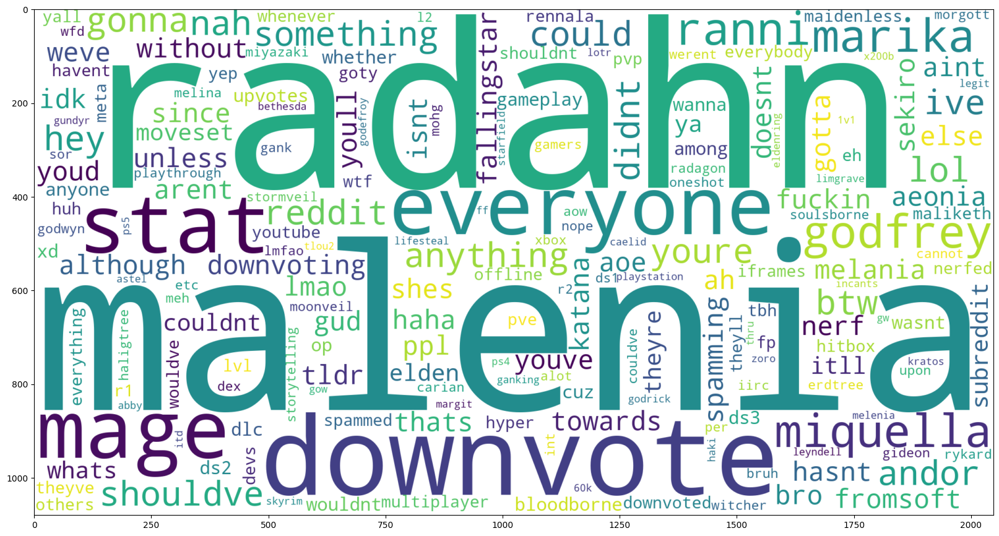

In [ ]:
#common words in gaming subreddits
wordcloud(' '.join([str(elem) for elem in common_words[0]]))

In [ ]:
tagged_tokens = nltk.pos_tag(frequent_words)
filtered_words = [word for word, tag in tagged_tokens if tag.startswith('NN') and word not in english_words]
# print the frequent words
print(filtered_words)

['zeus', 'mario', 'mobas', 'moba', 'cases', 'isnt', 'lol', 'taunts', 'happens', 'tf2', 'cosmetics', 'posts', 'morons', 'points', 'heroes', 'lines', 'sounds', 'names', 'haha', 'guys', 'wc3', 'words', 'characters', 'hes', 'games', 'meme', 'lives', 'responses', 'cares', 'features', 'cm', 'gods', 'others', 'things', 'hates', 'opponents', 'teams', 'friends', 'jesus', 'plays', 'goddamn', 'ti5', 'subreddit', 'le', 'reddit', 'threads', 'suggestions', 'pieces', 'moments', 'germany', 'ffs', 'kinda', 'fits', 'skins', 'fucks', 'events', 'bro', 'antimage', 'hundreds', 'thousands', 'hours', 'hon', 'esport', 'ok', 'jumping', 'cents', 'jokes', 'mindset', 'youll', 'items', 'servers', 'hats', 'players', 'fps', 'playstyle', 'ones', 'ages', 'lets', 'keeps', 'months', 'okay', 'children', 'personalities', 'legends', 'aspects', 'matters', 'loves', 'ideas', 'patches', 'esports', 'rubick', 'ends', 'snipers', 'dota2', 'guidelines', 'knows', 'particles', 'standards', 'issues', 'animations', 'brings', 'heres', 'd

In [ ]:
import nltk
nltk.download('words')

[nltk_data] Downloading package words to
[nltk_data]     C:\Users\ani_d\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping corpora\words.zip.


True

In [ ]:
nltk.download('punkt')
nltk.download('brown')
nltk.download('twitter_samples')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\ani_d\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package brown to
[nltk_data]     C:\Users\ani_d\AppData\Roaming\nltk_data...
[nltk_data]   Package brown is already up-to-date!
[nltk_data] Downloading package twitter_samples to
[nltk_data]     C:\Users\ani_d\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping corpora\twitter_samples.zip.


True

Slangs and acronyms:
['nah', 'didnt', 'andor', 'could', 'ive', 'something', 'anything', 'lol', 'shouldve', 'hey', 'youre', 'gonna', 'btw', 'reddit', 'downvotes', 'downvoting', 'melania', 'fromsoft', 'ah', 'fuckin', 'malenia', 'since', 'isnt', 'idk', 'doesnt', 'although', 'aeonia', 'aint', 'tldr', 'without', 'arent', 'else', 'youve', 'fallingstar', 'gud', 'weve', 'youd', 'everyones', 'haha', 'ppl', 'aoe', 'unless', 'lmao', 'radahn', 'thats', 'hasnt', 'towards', 'nerf', 'spamming', 'shes', 'gotta', 'bro', 'katana', 'youll', 'sekiro', 'couldnt', 'moveset', 'subreddit', 'itll', 'whats', 'ya', 'elden', 'downvote', 'theyre', 'gameplay', 'anyone', 'ds3', 'whether', 'dlc', 'among', 'upvotes', 'op', 'xd', 'wasnt', 'bloodborne', 'wouldnt', 'ds2', 'wanna', 'cuz', 'everyone', 'multiplayer', 'mage', 'pvp', 'stats', 'stat', 'yep', 'eh', 'youtube', 'offline', 'devs', 'goty', 'shouldnt', 'wouldve', 'theyve', 'iframes', 'everybody', 'pve', 'fp', 'downvoted', 'meta', 'hitbox', 'havent', 'r1', 'whenever'

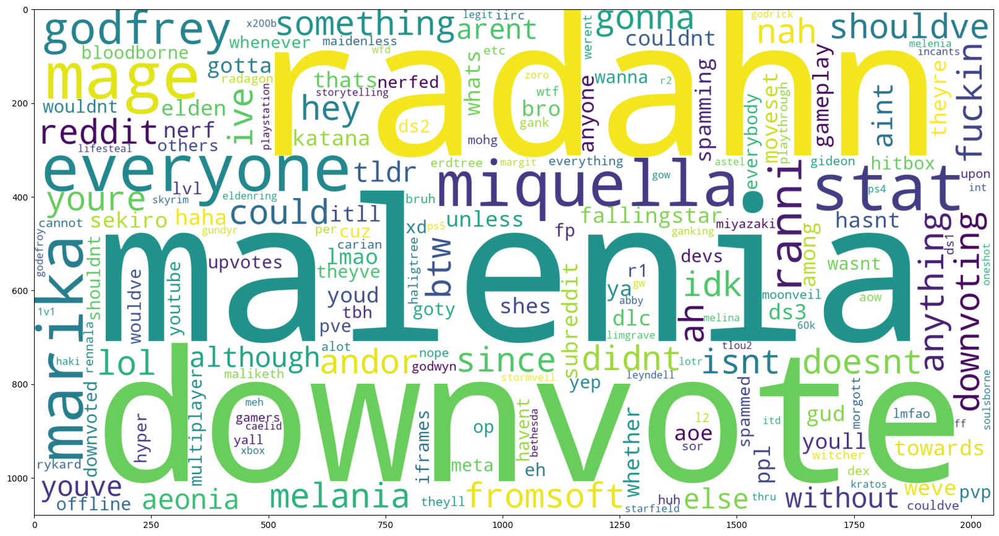

In [ ]:
filtered_words = [word for word in frequent_words if not wordnet.synsets(word)]
# print the frequent words
print("Slangs and acronyms:")
print(filtered_words)
wordcloud(' '.join([str(elem) for elem in filtered_words]))

In [ ]:
# text = 'Lol I think I need some zigs before I go out. LOL, that was a funny joke!'

# english_words = set(ws.words())


# tokenize the text into words and match the regular expression
words = ["spirits", "comments", "lol", "afk", "kinda", "whoppin","Leefhri"]
# tokens = word_tokenize(text)
tagged_tokens = nltk.pos_tag(words)
print(tagged_tokens)
if "spirits" not in english_words:
    print("Whoa")

[('spirits', 'NNS'), ('comments', 'NNS'), ('lol', 'VBP'), ('afk', 'JJ'), ('kinda', 'NN'), ('whoppin', 'NN'), ('Leefhri', 'NNP')]
Whoa


In [3]:
if not wordnet.synsets("everything"): #larp, dox, streamsnipe
    print("Whoa")

Whoa


In [ ]:
Counter(words)

Counter({'lol': 2,
         'think': 1,
         'need': 1,
         'some': 1,
         'zigs': 1,
         'before': 1,
         'go': 1,
         'out': 1,
         'that': 1,
         'was': 1,
         'funny': 1,
         'joke': 1})

In [33]:
# subreddits = ['eldenring','minecraft','overwatch','dota2','csgo','leagueoflegends']
for sub in subreddits:
    filename = 'posts_'+sub+'.json'
    with open('data/'+filename, 'r') as f:
        text = ''
        c = 0
        uc = 0
        data = json.load(f)
        
        wtd = 0
        users = set()
        for post in data:
            
            num_comments = len(post['comments'])
            c+=num_comments
            # for comment in post['comments']:
            #     for u in comment.keys():
            #         users.add(u)
            # uf = Counter(users)
            # uc+=len(uf)
            # wtd += len(users)/len(uf)*num_comments
        print("Sub = ",sub,", Total comments = ",c)
        # print("Average number of comments = ",c/len(data))
        # print("Average number of users commenting = ",len(users)/len(data))
        # print("Average number of times users commented = ",c/len(users))


Sub =  girlgamers , Total comments =  4005
Sub =  gaming , Total comments =  47237
Sub =  csgo , Total comments =  1831
Sub =  dota2 , Total comments =  27191
Sub =  leagueoflegends , Total comments =  63207
Sub =  minecraft , Total comments =  8179
Sub =  eldenring , Total comments =  6187
Sub =  truegaming , Total comments =  9728
Sub =  overwatch , Total comments =  14804
Sub =  mademesmile , Total comments =  18092
Sub =  wholesomememes , Total comments =  8604
Sub =  politicalhumor , Total comments =  4986
Sub =  memes , Total comments =  4646
Sub =  funny , Total comments =  31060
Sub =  askreddit , Total comments =  73635
Sub =  aww , Total comments =  15713
Sub =  worldnews , Total comments =  45183
Sub =  movies , Total comments =  43613
Sub =  todayilearned , Total comments =  35855


In [2]:
import json
subreddits = ['memes','mademesmile','politicalhumor','funny','askreddit']

for sub in subreddits:
    filename = 'posts_'+sub+'.json'
    with open('data/'+filename, 'r') as f:
        c = 0
        # uc = 0
        data = json.load(f)
        
        wtd = 0
        users = set()
        print(len(data))
        for post in data:
            
            num_comments = len(post['comments'])
            c+=num_comments
            for comment in post['comments']:
                for u in comment.keys():
                    users.add(u)
            # uf = Counter(users)
            # uc+=len(uf)
            # wtd += len(users)/len(uf)*num_comments
        print("Sub = ",sub)
        print("Average number of comments = ",c/len(data))
        print("Average number of users commenting = ",len(users)/len(data))
        print("Average number of times users commented = ",c/len(users))

99
Sub =  memes
Average number of comments =  46.92929292929293
Average number of users commenting =  23.828282828282827
Average number of times users commented =  1.9694785926239933
97
Sub =  mademesmile
Average number of comments =  186.51546391752578
Average number of users commenting =  120.03092783505154
Average number of times users commented =  1.553895044232586
96
Sub =  politicalhumor
Average number of comments =  51.9375
Average number of users commenting =  20.65625
Average number of times users commented =  2.514372163388805
100
Sub =  funny
Average number of comments =  310.6
Average number of users commenting =  178.69
Average number of times users commented =  1.7382058313279982
40
Sub =  askreddit
Average number of comments =  1840.875
Average number of users commenting =  936.875
Average number of times users commented =  1.9649099399599732


In [70]:
gsub = ["girlgamers", "gaming", "csgo", "dota2", "leagueoflegends",  "minecraft", "eldenring", "truegaming", "overwatch"]

ngsub = ["askreddit", "mademesmile", "wholesomememes", "politicalhumor", "memes", "funny", 'aww', 'worldnews', 'movies','todayilearned','diy']

def metanal(subreddits):
    ac = []
    au = []
    puc = []
    for sub in subreddits:
        filename = 'posts_'+sub+'.json'
        with open('data/'+filename, 'r') as f:
            c = 0
            # uc = 0
            data = json.load(f)
            
            wtd = 0
            users = set()
            print(len(data))
            for post in data:
                
                num_comments = len(post['comments'])
                c+=num_comments
                for comment in post['comments']:
                    for u in comment.keys():
                        users.add(u)
                # uf = Counter(users)
                # uc+=len(uf)
                # wtd += len(users)/len(uf)*num_comments
            print("Sub = ",sub)
            ac.append(c/len(data))
            au.append(len(users)/len(data))
            puc.append(c/len(users))
    y = []
    y.append(np.mean(ac))
    y.append(np.mean(au))
    y.append(np.mean(puc))
    print(y)
    return y

y = metanal(gsub)
yng = metanal(ngsub)

115
Sub =  girlgamers
99
Sub =  gaming
92
Sub =  csgo
100
Sub =  dota2
100
Sub =  leagueoflegends
100
Sub =  minecraft
99
Sub =  eldenring
100
Sub =  truegaming
100
Sub =  overwatch
[202.82829161176988, 87.88867466939931, 2.328555558408976]
40
Sub =  askreddit
97
Sub =  mademesmile
79
Sub =  wholesomememes
96
Sub =  politicalhumor
99
Sub =  memes
100
Sub =  funny
96
Sub =  aww
103
Sub =  worldnews
82
Sub =  movies
88
Sub =  todayilearned
90
Sub =  diy
[380.61799120888975, 200.21028185297874, 1.8769455835107762]


Text(0.5, 1.0, 'Average activity per post (normalized)')

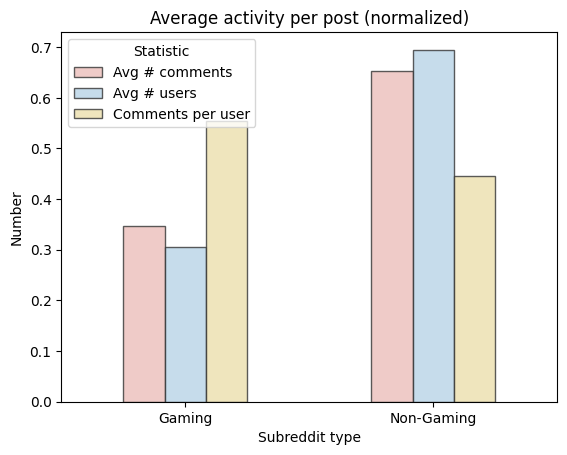

In [81]:

data = [['Avg # comments', y[0]/(y[0]+yng[0]), 'Gaming'], ['Avg # comments', yng[0]/(y[0]+yng[0]), 'Non-Gaming'],['Avg # users', y[1]/(y[1]+yng[1]), 'Gaming'], ['Avg # users', yng[1]/(y[1]+yng[1]), 'Non-Gaming'],['Comments per user', y[2]/(y[2]+yng[2]), 'Gaming'], ['Comments per user', yng[2]/(y[2]+yng[2]), 'Non-Gaming']]
df = pd.DataFrame(data, columns=['Statistic', 'Number','Subreddit type'])
colors = ['#f5b7b1', '#aed6f1', '#f9e79f', '#a9cce3', '#a3e4d7', '#f0b27a']

sns.barplot(x = 'Subreddit type',
          y = 'Number',
          hue = 'Statistic',
          palette = colors,
          data = df,
          estimator = np.median,
          edgecolor=".2",
            capsize=.1,
            saturation=.7,
            dodge=True,
            alpha=.8,
            width=0.5,
          errorbar=('ci', 0))
plt.title("Average activity per post (normalized)")

In [8]:
from nltk.sentiment.vader import SentimentIntensityAnalyzer
import pandas as pd

def ratio(sentences, type='vader'):
    if type=='vader':
        sia = SentimentIntensityAnalyzer()
        pos = 0
        for x in sentences:
            score = sia.polarity_scores(x)['compound']
            if score>=0:
                pos+=1

        return (len(sentences)-pos)/pos
    

In [8]:
import nltk

nltk.download('vader_lexicon')

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\ani_d\AppData\Roaming\nltk_data...


True

In [11]:
def get_comment_list(subreddit):
    filename = 'posts_' + subreddit + '.json'
    with open('data/'+filename, 'r') as f:
        text = []
        data = json.load(f)
        for post in data:
            for com in post['comments']:
                # print(com.values())
                if subreddit in ["pubg","valorant"]:
                    lst = re.findall('http://\S+|https://\S+', com)
                    for i in lst:
                        com = com.replace(i, '')
                    for punc in regular_punct:
                        if punc in com:
                            com = com.replace(punc, '')
                    clean_text = ""
                    for word in com.split():
                        if word not in stop_words:
                            clean_text+=(word+" ")
                    text.append(str(clean_text[:-1].strip()).lower())
                    continue
                for comment in com.values():
                    lst = re.findall('http://\S+|https://\S+', comment)
                    for i in lst:
                        comment = comment.replace(i, '')
                    for punc in regular_punct:
                        if punc in comment:
                            comment = comment.replace(punc, '')
                    clean_text = ""
                    for word in comment.split():
                        if word not in stop_words:
                            clean_text+=(word+" ")
                    text.append(str(clean_text[:-1].strip()).lower())
        return text

### Ratio of negative to positive comments

In [61]:
import random
num_samples = 1500
gsub = ["valorant","pubg", "girlgamers", "gaming", "csgo", "dota2", "leagueoflegends",  "minecraft", "eldenring", "truegaming", "overwatch"]

ngsub = ["askreddit", "mademesmile", "wholesomememes", "politicalhumor", "memes", "funny", 'aww', 'worldnews', 'movies','todayilearned','diy']
xg = []
for subreddit in gsub:
    # text = preprocess(subreddit)
    text = get_comment_list(subreddit)
    # print(len(text))
    sampled = random.sample(text, num_samples)
    print(f"Gaming Sub = r/{subreddit}, Ratio = {ratio(sampled)}")
    xg.append(ratio(text))


    

In [51]:
xng =[]
for subreddit in ngsub:
    # text = preprocess(subreddit)
    text = get_comment_list(subreddit)
    sampled = random.sample(text, num_samples)
    print(f"Sub = r/{subreddit}, Ratio = {ratio(sampled)}")
    xng.append(ratio(sampled))

Sub = r/askreddit, Ratio = 0.486013986013986
Sub = r/mademesmile, Ratio = 0.2327773749093546
Sub = r/wholesomememes, Ratio = 0.6585365853658537
Sub = r/politicalhumor, Ratio = 0.6683022571148185
Sub = r/memes, Ratio = 0.5017667844522968
Sub = r/funny, Ratio = 0.4795474325500435
Sub = r/aww, Ratio = 0.3086989992301771
Sub = r/worldnews, Ratio = 0.6314779270633397
Sub = r/movies, Ratio = 0.42737195633921077
Sub = r/todayilearned, Ratio = 0.47186147186147187
Sub = r/diy, Ratio = 0.3809910641754671


In [62]:
import numpy as np
print("Avg Gaming = ",np.mean(xg))
print("Avg NonGaming = ",np.mean(xng))

Avg Gaming =  0.4757486558919792
Avg NonGaming =  0.47703143991600183


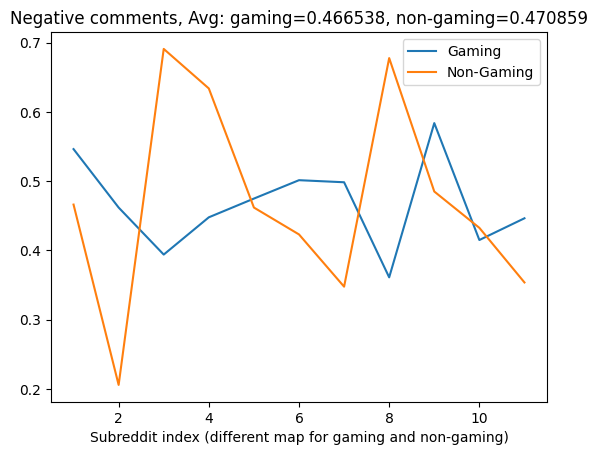

In [33]:
fig, ax = plt.subplots()
ax.plot(np.arange(1,12), xg, label='Gaming')
ax.plot(np.arange(1,12), xng, label='Non-Gaming')
ax.set(xlabel='Subreddit index (different map for gaming and non-gaming)')
plt.title(f"Negative comments, Avg: gaming={np.mean(xg):2f}, non-gaming={np.mean(xng):2f}")
ax.legend()

In [36]:
for subreddit in ['todayilearned']:
    # text = preprocess(subreddit)
    text = get_comment_list(subreddit)
    print(f"Sub = r/{subreddit}, Ratio = {ratio(text)}")

Sub = r/todayilearned, Ratio = 2.2364875965171676


In [12]:
# from nltk.sentiment.vader import SentimentIntensityAnalyzer
for subreddit in subreddits:
    filename = 'posts_'+sub+'.json'

    text = preprocess(subreddit)
    sia = SentimentIntensityAnalyzer()
    score = sia.polarity_scores(text)['compound']
    print("Sub: r/"+subreddit+", score = ",score)
    

Sub: r/girlgamers, score =  1.0
Sub: r/gaming, score =  1.0
Sub: r/csgo, score =  -0.9782
Sub: r/dota2, score =  1.0
Sub: r/leagueoflegends, score =  1.0
Sub: r/minecraft, score =  1.0
Sub: r/eldenring, score =  1.0
Sub: r/truegaming, score =  1.0
Sub: r/overwatch, score =  1.0
Sub: r/mademesmile, score =  1.0
Sub: r/wholesomememes, score =  0.9966
Sub: r/politicalhumor, score =  -1.0
Sub: r/memes, score =  -0.9998
Sub: r/funny, score =  1.0
Sub: r/askreddit, score =  1.0
Sub: r/aww, score =  1.0
Sub: r/worldnews, score =  -1.0
Sub: r/movies, score =  1.0


In [30]:
import heapq
from collections import Counter

badwords_list=[]
with open('bad_words.txt','rb') as lang_file:
    for word in lang_file:
        # print(word.decode().lower().strip('\n'))
        badwords_list.append(word.decode().lower().strip('\r\n'))
badwords = set(badwords_list)

for subreddit in subreddits:
    filename = 'posts_'+sub+'.json'
    comments = get_comment_list(subreddit)
    c = 0
    all_abuses = dict()
    for line_number,sentence in enumerate(comments):
        for key in ['.', ',', '"', "'", '?', '!', ':', ';', '(', ')', '[', ']', '{', '}', '’']:
            sentence = sentence.replace(key,'')

        # if line_number==0:
        #     print(sentence)
        abuses=[i for i in sentence.split() if i in badwords]
        if abuses == []:
            continue
        else:
            # print(abuses)
            c+=1
            all_words_counter = Counter(all_abuses)
            words_counter = Counter(abuses)
            all_words_counter.update(words_counter)
            all_abuses = dict(all_words_counter)
    print(f"Total {c/len(comments)*100:.2f}% comments are abusive in r/{subreddit}")
    abuses = heapq.nlargest(min(len(all_abuses), 5), all_abuses, key=all_abuses.get)
    print("Common abuses found: ", abuses)

Total 16.45% comments are abusive in r/girlgamers
Common abuses found:  ['shit', 'sex', 'shitty', 'fucking', 'fuck']
Total 13.94% comments are abusive in r/gaming
Common abuses found:  ['shit', 'fuck', 'fucking', 'ass', 'bullshit']
Total 9.23% comments are abusive in r/csgo
Common abuses found:  ['shit', 'fuck', 'fucking', 'ass', 'asshole']
Total 15.52% comments are abusive in r/dota2
Common abuses found:  ['shit', 'fucking', 'fuck', 'bullshit', 'ass']
Total 13.82% comments are abusive in r/leagueoflegends
Common abuses found:  ['shit', 'fuck', 'fucking', 'bullshit', 'asshole']
Total 8.96% comments are abusive in r/minecraft
Common abuses found:  ['fuck', 'shit', 'fucking', 'shitty', 'bitch']
Total 8.74% comments are abusive in r/eldenring
Common abuses found:  ['shit', 'fucking', 'ass', 'fuck', 'bullshit']
Total 11.93% comments are abusive in r/truegaming
Common abuses found:  ['shit', 'fuck', 'fucking', 'shitty', 'sex']
Total 11.94% comments are abusive in r/overwatch
Common abuses f

In [41]:
def analyze_abuse(subs):
    netabuse = set()
    per = 0.
    for subreddit in subs:
        comments = get_comment_list(subreddit)
        c = 0
        all_abuses = dict()
        for _,sentence in enumerate(comments):
            for key in ['.', ',', '"', "'", '?', '!', ':', ';', '(', ')', '[', ']', '{', '}', '’']:
                sentence = sentence.replace(key,'')

            # if line_number==0:
            #     print(sentence)
            abuses=[i for i in sentence.split() if i in badwords]
            if abuses == []:
                continue
            else:
                # print(abuses)
                c+=1
                all_words_counter = Counter(all_abuses)
                words_counter = Counter(abuses)
                all_words_counter.update(words_counter)
                all_abuses = dict(all_words_counter)
        print(f"Total {c/len(comments)*100:.2f}% comments are abusive in r/{subreddit}")
        abuses = heapq.nlargest(min(len(all_abuses), 25), all_abuses, key=all_abuses.get)
        netabuse.update(abuses)
        per += (c/len(comments))
    print("Common abuses found: ", list(netabuse)[-5:])
    print("Avg: ",per/len(subs)*100, "%")

gaming_subs = ["girlgamers", "gaming", "csgo", "dota2", "leagueoflegends",  "minecraft", "eldenring", "truegaming", "overwatch"]

analyze_abuse(gaming_subs)
nongaming_subs = ["mademesmile", "wholesomememes", "politicalhumor", "memes", "funny", "askreddit", 'aww', 'worldnews', 'movies', 'todayilearned']
analyze_abuse(nongaming_subs)

Total 16.45% comments are abusive in r/girlgamers
Total 13.94% comments are abusive in r/gaming
Total 9.23% comments are abusive in r/csgo
Total 15.52% comments are abusive in r/dota2
Total 13.82% comments are abusive in r/leagueoflegends
Total 8.96% comments are abusive in r/minecraft
Total 8.74% comments are abusive in r/eldenring
Total 11.93% comments are abusive in r/truegaming
Total 11.94% comments are abusive in r/overwatch
Common abuses found:  ['nude', 'slut', 'twat', 'boner', 'rape']
Avg:  12.283072506442211 %
Total 6.33% comments are abusive in r/mademesmile
Total 15.39% comments are abusive in r/wholesomememes
Total 10.65% comments are abusive in r/politicalhumor
Total 9.47% comments are abusive in r/memes
Total 15.04% comments are abusive in r/funny
Total 20.51% comments are abusive in r/askreddit
Total 11.23% comments are abusive in r/aww
Total 11.13% comments are abusive in r/worldnews
Total 10.38% comments are abusive in r/movies
Total 12.01% comments are abusive in r/to

In [8]:

import pandas as pd

subreddits = ["gaming","leagueoflegends","apexlegends","MortalKombat","FortNiteBR"]
chunksize = 10 ** 6
filtered = ""

for chunk in pd.read_csv('../kaggle_RC_2019-05.csv/kaggle_RC_2019-05.csv', chunksize=chunksize):
    filtered += ''.join(chunk.loc[chunk['subreddit'].isin(subreddits)]['body'].values)
    print(filtered)
    break


It's pretty well known and it was a paid product placement. Hamilton advertised the watch around the movie and had an Interstellar page on their website. The biggest product placement was the Carhartt jacket though.   Brands send old merch all the time by the way for movies. Just watch Stranger Things for tons of examples of that. Eggos are prominently featured as Eleven's favorite food.Why would we want to?TLDR:

"We invested a lot of brain power and scientific mumbo jumbo to still get your personalized shop wrong - you are welcome."

Thanks Riot&gt;I cant handle the turn delay, the idea of counter csing, the animations,

&gt; Gatekeep all you like.


**You** said you "can't handle" the more difficult mechanics. Lordy Leauge players are all the same..If you got the option just plug in a cable, so much more stable and 9/10 times faster as well, especially for downloads.YOU FREAKING FRICKS!!! When will you learn that your actions have CONSEQUENCES???I fail to see how that makes it not a

In [13]:
import os
import json
import multiprocessing
from tqdm import tqdm

file_paths = []
for f in os.listdir("reddit_all"):
    file_paths.append(f)

# 10k
gaming = ["girlgamers", "gaming", "csgo", "dota2", "leagueoflegends",  "minecraft", "eldenring", "truegaming", "overwatch"]
# ng = ["mademesmile", "wholesomememes", "politicalhumor", "memes", "funny", "askreddit", "", 'aww', 'worldnews', 'movies', 'pics']

def append_to_json(gcom, gstr): 
    with open(gstr+".json", 'ab+') as f:
        f.seek(0,2)                                #Go to the end of file    
        if f.tell() == 0 :                         #Check if file is empty
            f.write(json.dumps(gcom).encode())  #If empty, write an array
        else :
            f.seek(-1,2)           
            f.truncate()                           #Remove the last character, open the array
            f.write(' , '.encode())                #Write the separator
            f.write(json.dumps(gcom)[1:].encode())

def process(filename):
    gcom = []
    ngcom = []
    x = filename.split('_')
    print(x)
    # _,y,d,_ = x
    # if not os.path.exists("reddit_all/"+y+"_"+d):
    #     os.mkdir("reddit_all/"+y+"_"+d)
    # with open(filename, 'r') as fp:
    #     data = list(fp)
        
    #     os.chdir("reddit_all/"+y+"_"+d)
    #     # if f.startswith():
    #     k=0
    #     for comment in tqdm(data):
    #         comment = json.loads(comment)
    #         if comment['subreddit'] in gaming:
    #             gcom.append(comment)
    #             k+=1
    #         else:
    #             ngcom.append(comment)
    #         if len(gcom)==10000:
    #             append_to_json(gcom,"gaming") # Dump the dictionary
    #             gcom = []
    #         if len(ngcom)==10000:
    #             append_to_json(ngcom,"nongaming")
    #             ngcom = []
    # print(filename,": ",k)

process('reddit_all/RC_2011_01_0000.jsonl')
# num_processes = multiprocessing.cpu_count()
# pool = multiprocessing.Pool(processes=4)

# # map the process_file function to each file path in parallel
# pool.map(process, file_paths)

# # close the pool to release resources
# pool.close()
# pool.join()

In [13]:
import nltk
nltk.download('vader_lexicon')

AttributeError: partially initialized module 'nltk' has no attribute 'data' (most likely due to a circular import)

In [14]:
from nltk.sentiment.vader import SentimentIntensityAnalyzer
sia = SentimentIntensityAnalyzer()
score = sia.polarity_scores(filtered)['compound']
print("Gaming score = ",score)

AttributeError: partially initialized module 'nltk' has no attribute 'data' (most likely due to a circular import)